<a href="https://colab.research.google.com/github/tapiwamesa/Wisconsin-Breast-Cancer-Classification/blob/main/Breast_Cancer_Tumor_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Wisconsin Breast Cancer Classification**

# Problem Definition

The goal of this project is to build a machine learning model that can accurately classify whether a tumor is benign or malignant based on features derived from a digitized image of a breast mass. The dataset, known as the Wisconsin Breast Cancer Dataset, contains various attributes computed from cell nuclei present in breast fine needle aspirates (FNA), such as radius, texture, perimeter, area, and smoothness.

Accurate classification of tumors is critical for timely diagnosis and treatment planning. By automating this classification, we aim to assist medical professionals in improving diagnostic accuracy and reducing the time taken for clinical decision-making.

# Objectives

1.   Preprocess the dataset to handle missing values and scale features appropriately.
2.   Train and evaluate classification models thus the K-Nearest Neighbor (KNN) and the Logistic Regression.
3.   Use metrics like accuracy, precision, recall, and F1-score to assess performance.






# Exploratory Data Analysis

In [ ]:
# importing basic modules

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# importing the dataset

from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()

Datasets build in scikit-learn are usually stored as
 Bunch objects, which contain some information about the dataset as well as the actual data. Bunch objects is that they behave like dictionaries

In [ ]:
# viewing the data

cancer.keys()

dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])

In [ ]:
# we rearrage the data to a dataframe so we can easily work with it

In [ ]:
# this is the X, or independnet variables
cancer["data"]

array([[1.799e+01, 1.038e+01, 1.228e+02, ..., 2.654e-01, 4.601e-01,
        1.189e-01],
       [2.057e+01, 1.777e+01, 1.329e+02, ..., 1.860e-01, 2.750e-01,
        8.902e-02],
       [1.969e+01, 2.125e+01, 1.300e+02, ..., 2.430e-01, 3.613e-01,
        8.758e-02],
       ...,
       [1.660e+01, 2.808e+01, 1.083e+02, ..., 1.418e-01, 2.218e-01,
        7.820e-02],
       [2.060e+01, 2.933e+01, 1.401e+02, ..., 2.650e-01, 4.087e-01,
        1.240e-01],
       [7.760e+00, 2.454e+01, 4.792e+01, ..., 0.000e+00, 2.871e-01,
        7.039e-02]])

In [ ]:
# this is the y, or the target variable which is "benign" and "malignment"
cancer["target"]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0,
       1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1,
       1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0,
       0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0,

In [ ]:
# these are the class names
cancer["target_names"]

array(['malignant', 'benign'], dtype='<U9')

In [ ]:
# these are column names/ feature names of the independent variables (X)
cancer["feature_names"]

array(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error',
       'fractal dimension error', 'worst radius', 'worst texture',
       'worst perimeter', 'worst area', 'worst smoothness',
       'worst compactness', 'worst concavity', 'worst concave points',
       'worst symmetry', 'worst fractal dimension'], dtype='<U23')

In [ ]:
# Combining the pieces into a readable data format
data = pd.DataFrame(cancer["data"], columns = cancer["feature_names"])

In [ ]:
# vewing the data
data.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
# we concat the column y into the data

data["target"] = cancer["target"]
data.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


In [ ]:
# Concatinating with a class names column

# redefining the order of the class to have 1 - malignment amd 0 - benign
class_reordered = pd.Series(['benign', 'malignant'])

data["target_names"] = data["target"].map(class_reordered)

In [ ]:
# viewing the complete dataset

data.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target,target_names
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0,benign
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0,benign
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0,benign
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0,benign
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0,benign


In [ ]:
# Shape of the data

data.shape

(569, 32)

In [ ]:
# now that the data is now complete lets look at the behavior of the data

# Viewing the column data types

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [ ]:
# Descriptive stats of the data

data.describe().T

,count,mean,std,min,25%,50%,75%,max
mean radius,569.0,14.127292,3.524049,6.981000,11.700000,13.370000,15.780000,28.11000
mean texture,569.0,19.289649,4.301036,9.710000,16.170000,18.840000,21.800000,39.28000
mean perimeter,569.0,91.969033,24.298981,43.790000,75.170000,86.240000,104.100000,188.50000
mean area,569.0,654.889104,351.914129,143.500000,420.300000,551.100000,782.700000,2501.00000
mean smoothness,569.0,0.096360,0.014064,0.052630,0.086370,0.095870,0.105300,0.16340
mean compactness,569.0,0.104341,0.052813,0.019380,0.064920,0.092630,0.130400,0.34540
mean concavity,569.0,0.088799,0.079720,0.000000,0.029560,0.061540,0.130700,0.42680
mean concave points,569.0,0.048919,0.038803,0.000000,0.020310,0.033500,0.074000,0.20120
mean symmetry,569.0,0.181162,0.027414,0.106000,0.161900,0.179200,0.195700,0.30400
mean fractal dimension,569.0,0.062798,0.007060,0.049960,0.057700,0.061540,0.066120,0.09744


In [ ]:
# Looking at data classes

data["target"].value_counts()

,count
target,
1,357
0,212


In [ ]:
# % view of the classes

data["target"].value_counts(normalize = True)

,proportion
target,
1,0.627417
0,0.372583


62.7% of the data is of class 1 thus malignent or a class of patients that have a cancerous tumor. 37.2% of the patients sampled in the dataset belong to class 0 or class for benign type of breast cancer. We can see that there is a moderation in class imbalance in the dataset classes of "malignent" and "benign"

In [ ]:
# Correlation of the independent variables

corr = data.iloc[ :, :31].corr()

<Axes: >

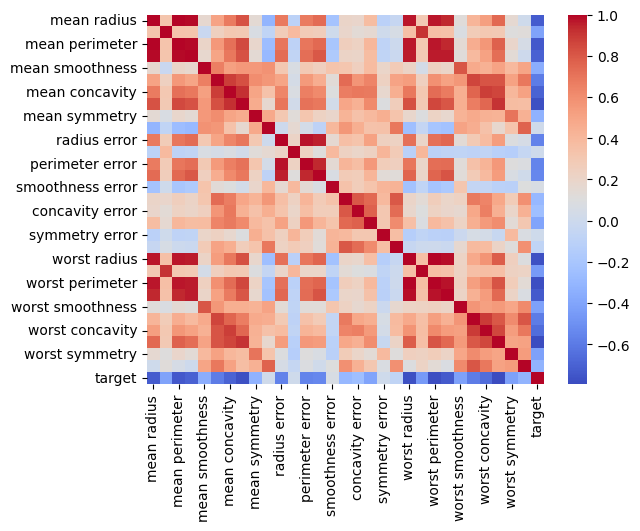

In [ ]:
# Correlation matric
sns.heatmap(corr, cmap = "coolwarm")

In [ ]:
# Visualization of the cancerous and non cancerous tumors
sns.pairplot(data, hue = "target_names", diag_kind = "hist")

From the diagram above the blue dots show non cancerous tumors and the oranges dots show cancerous tumors. The plot above depicts the distribution of the data for all the 31 variables being looked at in the problem. With each variable plotted against all the other variables.

# Data Preprocessing

In [ ]:
# Viewing the data
data.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target,target_names
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0,benign
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0,benign
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0,benign
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0,benign
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0,benign


In [ ]:
# importing machine learning dependencies for this section

from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

In [ ]:
# Splitting the data into target and features

X = data.iloc[ : , :30] # storing only the numeric values into our predictor set
y = data["target"]

In [ ]:
# Splitting the data inot train and test sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 42, stratify = y)

In [ ]:
# Training data shape
X_train.shape, y_train.shape

((426, 30), (426,))

In [ ]:
# Test data shape
X_test.shape, y_test.shape

((143, 30), (143,))


## *1. K-Nearest Neighbor Model*


In [ ]:
# Intantiating our model for training with KNN Model

neighbors = range(1, 21) # 20 neighbors
results = pd.DataFrame(columns = ["k", "Accuracy_Score", "Precision_Score", "Recall_Score", "F1_Score"])   # Dataframe to store results

# iterating the training of the model with varying neighbors from 1 to 20

for k in neighbors:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    Accuracy_Score = accuracy_score(y_test, y_pred)
    Precision_Score = precision_score(y_test, y_pred)
    Recall_Score = recall_score(y_test, y_pred)
    F1_Score = f1_score(y_test, y_pred)

    results.loc[len(results)] = [k, Accuracy_Score, Precision_Score, Recall_Score, F1_Score]

In [ ]:
# Viewing results

results

,k,Accuracy_Score,Precision_Score,Recall_Score,F1_Score
0,1.0,0.937063,0.955056,0.944444,0.949721
1,2.0,0.930070,0.954545,0.933333,0.943820
2,3.0,0.930070,0.934783,0.955556,0.945055
3,4.0,0.916084,0.943182,0.922222,0.932584
4,5.0,0.930070,0.934783,0.955556,0.945055
5,6.0,0.923077,0.943820,0.933333,0.938547
6,7.0,0.944056,0.945652,0.966667,0.956044
7,8.0,0.944056,0.945652,0.966667,0.956044
8,9.0,0.944056,0.945652,0.966667,0.956044
9,10.0,0.944056,0.945652,0.966667,0.956044


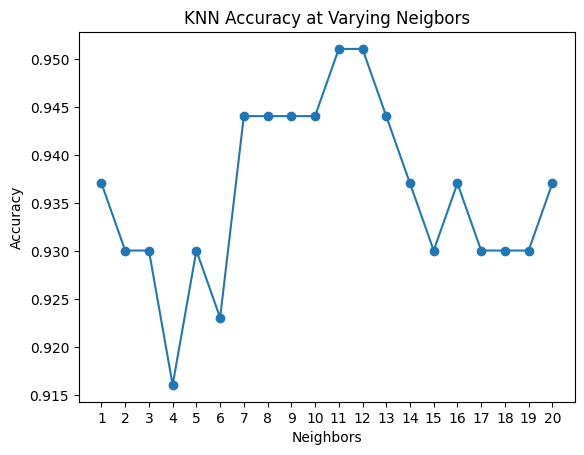

In [ ]:
# Plotting the results to find the optimal k or neighbors

plt.plot(results["k"], results["Accuracy_Score"], marker = "o")
plt.title("KNN Accuracy at Varying Neigbors")
plt.xlabel("Neighbors")
plt.ylabel("Accuracy")
plt.xticks(range(1, 21))
plt.show()

The KNN model's accuracy is high at k = 11 and k = 12 neighbors as shown from the visual plot. Precision score, which is the metric that measures the ratio of correct predicted positives out of all predicted positives is at peak at k = 11 and k = 12 with a metric of 0.946237, Recall score is at 0.978 which measure the % of correct positive predictions out of all actual positives. The F1 score sums it up at 0.961749.

## *2. Logistic Regression*

In [ ]:
# Importing the dependencies

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

In [ ]:
# Scaling data

scaler = StandardScaler()
X_train_scaled= scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
# Instanciating the logistic Regression model with default parameters

lg_results = pd.DataFrame(columns = ["Accuracy_Score", "Precision_Score", "Recall_Score", "F1_Score"]) # DataFrame to store results

lg = LogisticRegression(random_state = 42)
lg.fit(X_train_scaled, y_train)
lg_y_pred = lg.predict(X_test_scaled)
lg_Accuracy_Score = accuracy_score(y_test, lg_y_pred)
lg_Precision_Score = precision_score(y_test, lg_y_pred)
lg_Recall_Score = recall_score(y_test, lg_y_pred)
lg_F1_Score = f1_score(y_test, lg_y_pred)

# Appending the lg_results DataFrame with the metrics

lg_results.loc[len(lg_results)] = [lg_Accuracy_Score, lg_Precision_Score, lg_Recall_Score, lg_F1_Score]

In [ ]:
# Viewing the results

lg_results

,Accuracy_Score,Precision_Score,Recall_Score,F1_Score
0,0.986014,0.988889,0.988889,0.988889


# Conclusion

For this classification problem Logistic regression has the best accuracy from training accuracy to Prtecision score, recall and the overall F1 score.